In [7]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from glob import glob
from tqdm import tqdm
from natsort import natsorted
from latex import latexify
from PIL import Image

latexify(columns = 2)
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [8]:
def transform(src_pts, H):
    """Transform points with a homography matrix."""
    src = np.pad(src_pts, [(0, 0), (0, 1)], constant_values=1)
    pts = np.dot(H, src.T).T
    pts = (pts / pts[:, 2].reshape(-1, 1))[:, :2]
    return pts

def bilinear_interpolate(img, x, y):
    """Perform bilinear interpolation for non-integer coordinates."""
    x0 = np.floor(x).astype(int)
    x1 = x0 + 1
    y0 = np.floor(y).astype(int)
    y1 = y0 + 1

    x0 = np.clip(x0, 0, img.shape[1] - 1)
    x1 = np.clip(x1, 0, img.shape[1] - 1)
    y0 = np.clip(y0, 0, img.shape[0] - 1)
    y1 = np.clip(y1, 0, img.shape[0] - 1)

    Ia = img[y0, x0]
    Ib = img[y1, x0]
    Ic = img[y0, x1]
    Id = img[y1, x1]

    wa = (x1 - x) * (y1 - y)
    wb = (x1 - x) * (y - y0)
    wc = (x - x0) * (y1 - y)
    wd = (x - x0) * (y - y0)

    return (Ia * wa[:, None] + Ib * wb[:, None] + Ic * wc[:, None] + Id * wd[:, None])

def my_warp_perspective(img, H, size):
    """Warp an image with a given homography matrix and target size."""
    width, height = size

    idx_pts = np.mgrid[0:width, 0:height].reshape(2, -1).T
    
    map_pts = transform(idx_pts, np.linalg.inv(H))
    x_src, y_src = map_pts[:, 0], map_pts[:, 1]
    
    mask = (x_src >= 0) & (x_src < img.shape[1] - 1) & (y_src >= 0) & (y_src < img.shape[0] - 1)
    
    valid_x_src = x_src[mask]
    valid_y_src = y_src[mask]
    valid_idx_pts = idx_pts[mask]

    warped_pixels = bilinear_interpolate(img, valid_x_src, valid_y_src)
    
    warped = np.zeros((height, width, img.shape[2]), dtype=img.dtype)
    warped[valid_idx_pts[:, 1], valid_idx_pts[:, 0]] = warped_pixels

    return warped

In [9]:
from src.GuntasSaran.utils import compute_blending_weights, normalize_weights, transform_corners, get_shift_matrix_left_size, get_shift_matrix_right_size, cylindrical_warp
from src.GuntasSaran.homographies import estimate_homography

In [10]:
images_i1 = []
for im in tqdm(natsorted(glob('./images/i5/*.JPG'))):
    images_i1.append(cv2.imread(im))

images_i1 = np.array(images_i1)

100%|██████████| 5/5 [00:00<00:00, 24.62it/s]


In [11]:
images_i1[0].shape

(1329, 2000, 3)

In [12]:
def show_image_grid(images, M, N, title='Title', figsize=8):
    # Assuming 'images' is a numpy array of shape (num_images, height, width, channels)
    if M==1:
        row_size = figsize
        col_size = figsize//4
    elif N==1:
        row_size = figsize//4
        col_size = figsize
    else:
        row_size, col_size = figsize, figsize

    fig, axes = plt.subplots(M, N, figsize=(row_size, col_size))

    if len(images.shape) < 4:
        images = np.expand_dims(images.copy(), axis=0)

    fig.suptitle(title)
    for i in range(M):
        for j in range(N):
            if M==1 and N==1:
                ax = axes
            elif M == 1 or N==1:
                ax = axes[max(i, j)]
            else:
                ax = axes[i, j]
            index = i * N + j
            if index < images.shape[0]:
                ax.imshow(cv2.cvtColor(images[index], cv2.COLOR_BGR2RGB))
            ax.axis('off')
    plt.tight_layout()
    plt.show()

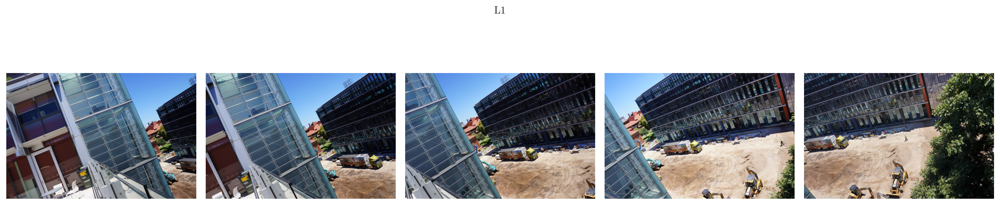

In [13]:
show_image_grid(images_i1, 1, 5, title='L1', figsize = 16)

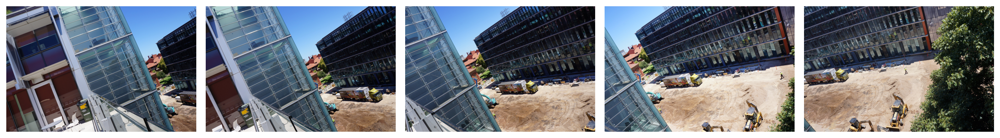

In [14]:
fig, axes = plt.subplots(1, 5, figsize=(16, 4))
for i, im in enumerate(images_i1):
    axes[i].imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
    axes[i].axis('off')
plt.tight_layout()
plt.show()

In [117]:
def cylindrical_warp(image, focal_length):
    h, w = image.shape[:2]
    x_c, y_c = w // 2, h // 2

    u, v = np.meshgrid(np.arange(w), np.arange(h))

    theta = (u - x_c) / focal_length
    h_cyl = (v - y_c) / focal_length

    x_hat = np.sin(theta)
    y_hat = h_cyl
    z_hat = np.cos(theta)

    x_img = (focal_length * x_hat / z_hat + x_c).astype(np.int32)
    y_img = (focal_length * y_hat / z_hat + y_c).astype(np.int32)

    valid_mask = (x_img >= 0) & (x_img < w) & (y_img >= 0) & (y_img < h)

    cylindrical_img = np.zeros_like(image)
    cylindrical_img[v[valid_mask], u[valid_mask]] = image[y_img[valid_mask], x_img[valid_mask]]

    cylindrical_img = Image.fromarray(cylindrical_img)
    cylindrical_img = cylindrical_img.crop((u[valid_mask].min(), v[valid_mask].min(), u[valid_mask].max(), v[valid_mask].max()))
    cylindrical_img = np.array(cylindrical_img)

    return cylindrical_img

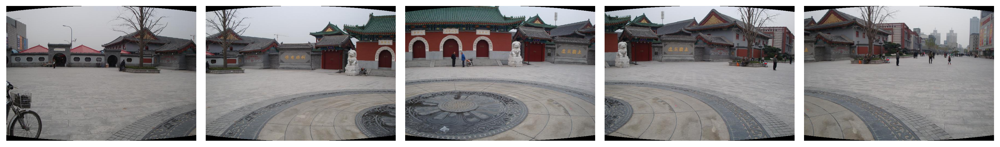

In [102]:
focal_length = 800

cylindrical_images = [cylindrical_warp(im, focal_length) for im in images_i1]

fig, axes = plt.subplots(1, 5, figsize=(16, 4))
for i, im in enumerate(cylindrical_images):
    axes[i].imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
    axes[i].axis('off')
plt.tight_layout()
plt.show()

In [20]:
def get_homographies(images, reference_idx, useOpenCV = False):
    """Takes in a list of images and returns a list of homographies between the images.

    Args:
        images (List): List of images to compute homographies for.
        reference_idx (int): Index of the reference image.
        useOpenCV (bool, optional): Defaults to False. Whether to use OpenCV's homography estimation or my own.

    Returns:
        List: List of homographies between the images.
    """
    homographies = []
    for i in range(1, reference_idx + 1):
        H = estimate_homography(images[i - 1], images[i], useOpenCV)
        homographies.append(H)
    
    for i in range(reference_idx, len(images) - 1):
        H = estimate_homography(images[i + 1], images[i], useOpenCV)
        homographies.append(H)
    
    return homographies

    
def blend_images_left(image1, image2, H, total_weight, shift_matrix):
    """Blend two images together from the left.

    Args:
        image1 (np.ndarray): Blended Image from Left.
        image2 (np.ndarray): Image Reference.
        H (np.ndarray): Homography matrix between the images.
        total_weight (np.ndarray): Total weight of the images.
        shift_matrix (np.ndarray): Shift matrix.

    Returns:
        np.ndarray: Blended image.
    """
    # initially pass total_weight as None and shift_matrix as np.eye(3)
    
    shift_matrix_new, size = get_shift_matrix_left_size(image1, image2, H @ np.linalg.inv(shift_matrix))
    shift_matrix_new = shift_matrix_new.astype(np.float64)
    
    image1_warped = cv2.warpPerspective(image1, shift_matrix_new @ H @ np.linalg.inv(shift_matrix), size)
    image2_warped = cv2.warpPerspective(image2, shift_matrix_new, size)
    
    if total_weight is None:
        total_weight = compute_blending_weights(image1, shift_matrix_new @ H, size)
    else:
        total_weight = cv2.warpPerspective(total_weight, shift_matrix_new @ H @ np.linalg.inv(shift_matrix), size)
    
    weight1 = total_weight.copy()
    weight2 = compute_blending_weights(image2, shift_matrix_new, size)
    
    weight1_normalised, weight2_normalised, total_weight = normalize_weights(weight1, weight2)
    
    image1_warped = image1_warped.astype(np.float64)
    image2_warped = image2_warped.astype(np.float64)
    weight1_normalised = weight1_normalised.astype(np.float64)
    weight2_normalised = weight2_normalised.astype(np.float64)
    
    blended_image = (image1_warped * weight1_normalised + image2_warped * weight2_normalised)
    print(np.unique(blended_image))
    blended_image = np.clip(blended_image / blended_image.max() * 255, 0, 255).astype(np.uint8)
    
    return blended_image, total_weight, shift_matrix_new
    
    
def blend_images_right(image_blended, image_ref, H, total_weight, shift_matrix):
    
    # image1 is the reference image and image2 is the image to be blended
    # initially pass total_weight as None and shift_matrix as np.eye(3)
    
    shift_matrix_new, size = get_shift_matrix_right_size(image_blended, image_ref, H @ np.linalg.inv(shift_matrix))
    shift_matrix_new = shift_matrix_new.astype(np.float64)
    warped_image_ref = cv2.warpPerspective(image_ref, shift_matrix_new, size)
    warped_image_blended = cv2.warpPerspective(image_blended, shift_matrix_new @ H @ np.linalg.inv(shift_matrix), size)
    
    if total_weight is None:
        total_weight = compute_blending_weights(image_blended, shift_matrix_new @ H, size)
    else:
        total_weight = cv2.warpPerspective(total_weight, shift_matrix_new @ H @ np.linalg.inv(shift_matrix), size)
    
    weight_blended = total_weight.copy()
    weight_ref = compute_blending_weights(image_ref, shift_matrix_new, size)
    
    weight_blended_normalised, weight_ref_normalised, total_weight = normalize_weights(weight_blended, weight_ref)
    
    warped_image_blended = warped_image_blended.astype(np.float64)
    warped_image_ref = warped_image_ref.astype(np.float64)
    weight_blended_normalised = weight_blended_normalised.astype(np.float64)
    weight_ref_normalised = weight_ref_normalised.astype(np.float64)
    
    blended_image = (warped_image_blended * weight_blended_normalised + warped_image_ref * weight_ref_normalised)
    print(np.unique(blended_image))
    blended_image = np.clip(blended_image / blended_image.max() * 255, 0, 255).astype(np.uint8)
    
    return blended_image, total_weight, shift_matrix_new

In [21]:
images = images_i1
if len(images) % 2 == 0:
    reference_idx = len(images) // 2 - 1
else:
    reference_idx = len(images) // 2

print(reference_idx)
homography_matrix_list = get_homographies(images, reference_idx, useOpenCV = False)
homography_matrix_list

2


[array([[ 1.27404247e+00,  5.92645304e-02, -6.37581788e+02],
        [ 2.95980229e-02,  1.14581609e+00, -6.26310760e+00],
        [ 1.32185443e-04, -2.15974057e-06,  1.00000000e+00]]),
 array([[ 1.29828600e+00,  4.59699489e-02, -6.80091901e+02],
        [ 4.74253286e-02,  1.18006254e+00, -1.13968087e+02],
        [ 1.40618246e-04,  1.14002056e-05,  1.00000000e+00]]),
 array([[ 8.05018104e-01, -4.40685753e-02,  4.55722369e+02],
        [-3.49003573e-02,  9.10462631e-01,  9.37960014e+01],
        [-9.36410547e-05, -1.28812144e-05,  1.00000000e+00]]),
 array([[ 7.47487008e-01, -3.08655911e-02,  6.26472886e+02],
        [-7.70312865e-02,  8.94330719e-01,  1.11094813e+02],
        [-1.24494631e-04, -1.46663549e-05,  1.00000000e+00]])]

[0.00000000e+00 3.32906823e-03 8.88028132e-03 ... 4.05517701e+02
 4.05651800e+02 4.06281570e+02]


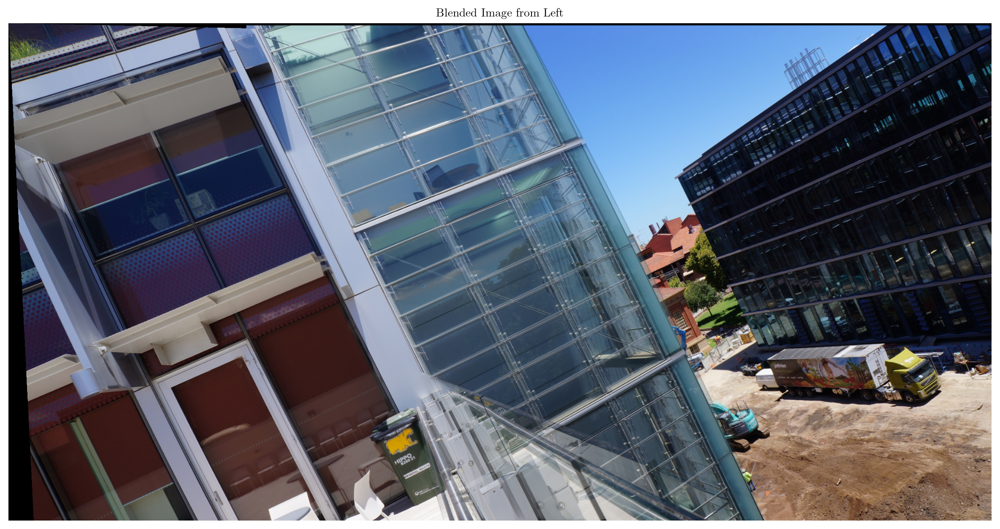

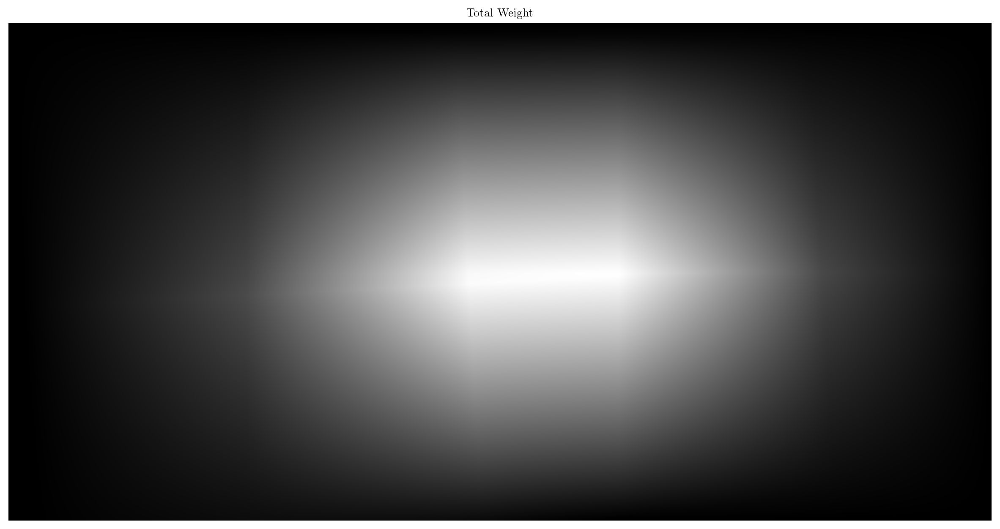

[0.00000000e+00 1.36273631e-01 3.33665225e-01 ... 3.91520875e+02
 3.91728278e+02 3.91728278e+02]


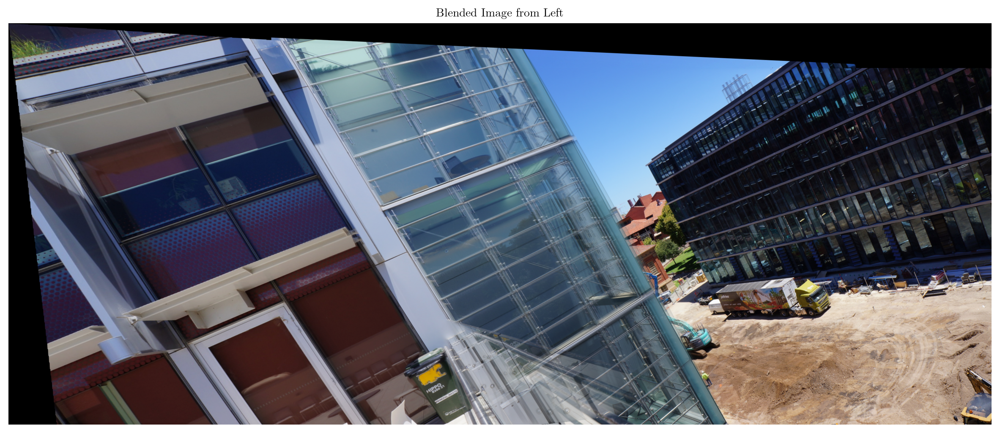

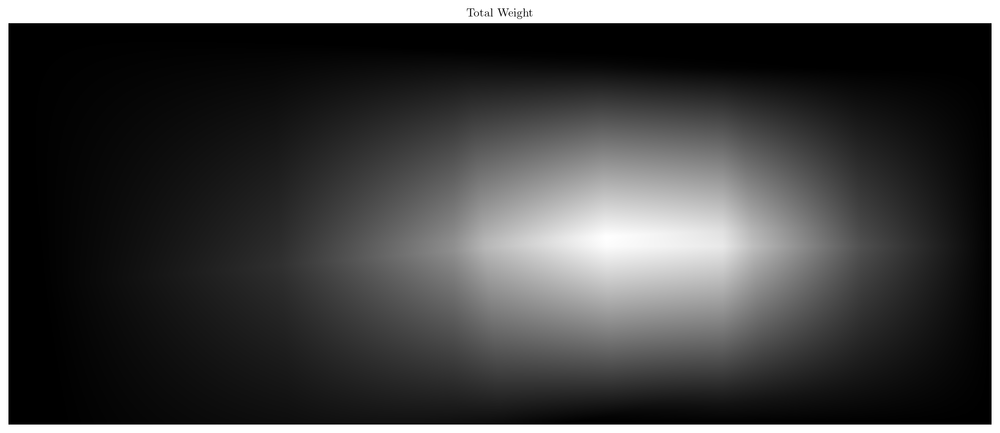

[0.00000000e+00 1.37045279e-03 2.74090558e-03 ... 3.57852633e+02
 3.57852633e+02 3.57852633e+02]


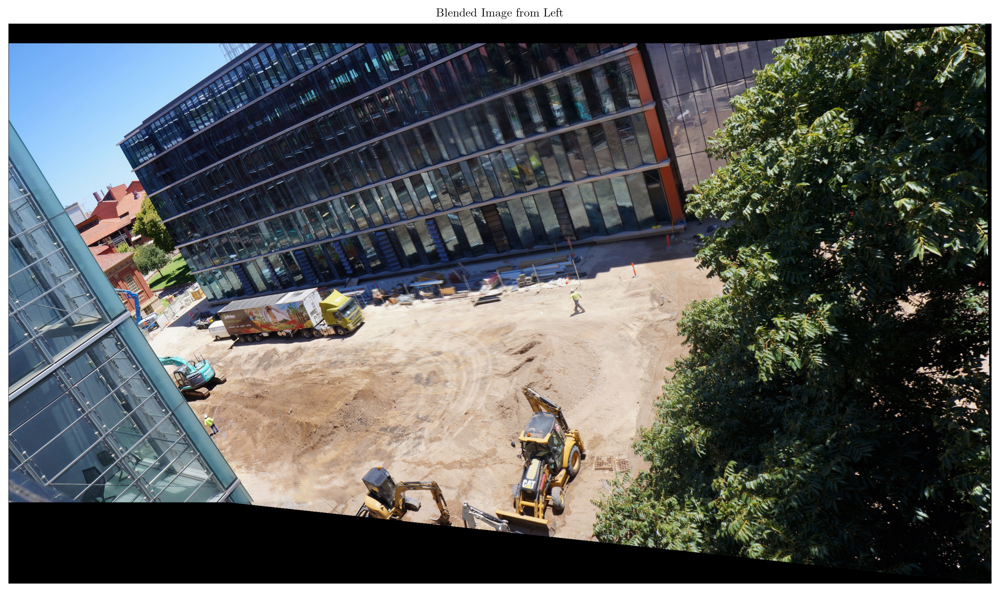

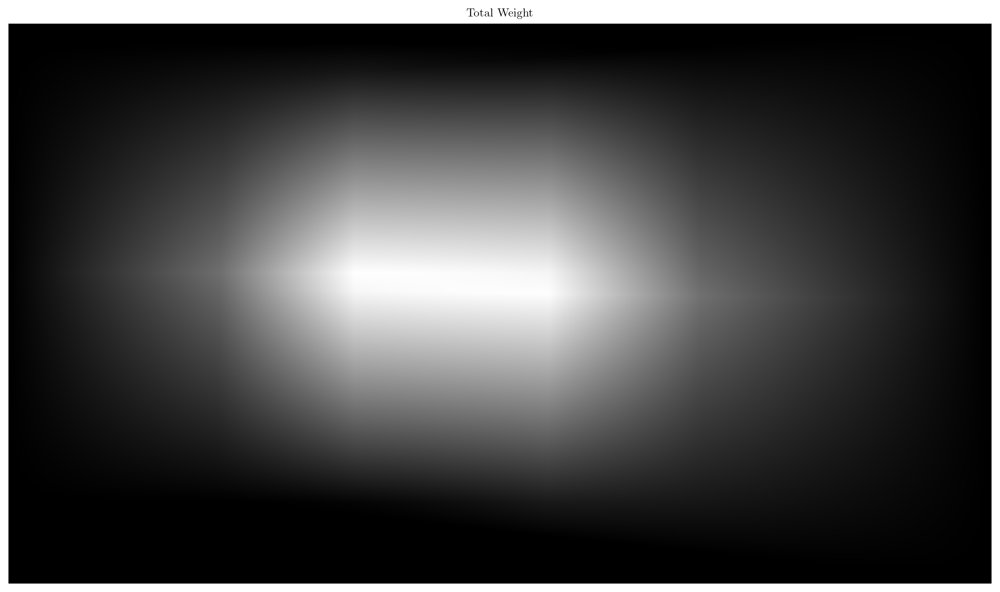

In [23]:
blended_image_left = images[0].astype(np.float64)
total_weight_left = None
shift_matrix_left = np.eye(3)
for i in range(1, reference_idx + 1):
    blended_image_left, total_weight_left, shift_matrix_left = blend_images_left(
        blended_image_left, images[i], homography_matrix_list[i - 1], total_weight_left, shift_matrix_left)
    
    plt.figure(figsize=(15, 15))
    plt.title('Blended Image from Left')
    plt.imshow(cv2.cvtColor(blended_image_left, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()
    
    plt.figure(figsize=(15, 15))
    plt.title('Total Weight')
    plt.imshow(total_weight_left, cmap='gray')
    plt.axis('off')
    plt.show()

blended_image_right = images[-1].astype(np.float64)
total_weight_right = None
shift_matrix_right = np.eye(3)

for i in range(len(images) - 2, reference_idx, -1):
    blended_image_right, total_weight_right, shift_matrix_right = blend_images_right(
       blended_image_right, images[i], homography_matrix_list[i], total_weight_right, shift_matrix_right)
    
    plt.figure(figsize=(15, 15))
    plt.title('Blended Image from Left')
    plt.imshow(cv2.cvtColor(blended_image_right, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()
    
    plt.figure(figsize=(15, 15))
    plt.title('Total Weight')
    plt.imshow(total_weight_right, cmap='gray')
    plt.axis('off')
    plt.show()

In [ ]:
H = homography_matrix_list[reference_idx]
        
corners, min_x, min_y, max_x, max_y = transform_corners(blended_image_right, H @ np.linalg.inv(shift_matrix_right))
corners1, min_x1, min_y1, max_x1, max_y1 = transform_corners(blended_image_left, np.linalg.inv(shift_matrix_left))

final_canvas_width = int(max_x - min_x1)
final_canvas_height = int(max(max_y, max_y1) - min(min_y, min_y1))

final_shift_matrix_left = np.array([[1, 0, -min_x1], [0, 1, -min(min_y1, min_y)], [0, 0, 1]])
final_shift_matrix_right = np.array([[1, 0, (final_canvas_width - max_x)], [0, 1, -min(min_y1, min_y)], [0, 0, 1]])

final_shift_matrix_left = final_shift_matrix_left.astype(np.float64)
final_shift_matrix_right = final_shift_matrix_right.astype(np.float64)

blended_image_left_final = cv2.warpPerspective(blended_image_left, final_shift_matrix_left @ np.linalg.inv(shift_matrix_left), (final_canvas_width, final_canvas_height))
blended_image_right_final = cv2.warpPerspective(blended_image_right, final_shift_matrix_right @ H @ np.linalg.inv(shift_matrix_right), (final_canvas_width, final_canvas_height))

total_weight_left_final = cv2.warpPerspective(total_weight_left, final_shift_matrix_left @ np.linalg.inv(shift_matrix_left), (final_canvas_width, final_canvas_height))

if total_weight_right is None:
    total_weight_right_final = compute_blending_weights(blended_image_right, final_shift_matrix_right @ H, (final_canvas_width, final_canvas_height))
else:
    total_weight_right_final = cv2.warpPerspective(total_weight_right, final_shift_matrix_right @ H @ np.linalg.inv(shift_matrix_right), (final_canvas_width, final_canvas_height))

total_weight_left_final_normalised, total_weight_right_final_normalised, _ = normalize_weights(total_weight_left_final, total_weight_right_final)

blended_image_left_final = blended_image_left_final.astype(np.float64)
blended_image_right_final = blended_image_right_final.astype(np.float64)
total_weight_left_final_normalised = total_weight_left_final_normalised.astype(np.float64)
total_weight_right_final_normalised = total_weight_right_final_normalised.astype(np.float64)

stitched_image = (blended_image_left_final * total_weight_left_final_normalised + blended_image_right_final * total_weight_right_final_normalised)
stitched_image = np.clip(stitched_image / stitched_image.max() * 255, 0, 255).astype(np.uint8)